<a href="https://colab.research.google.com/github/JuliaMerz/ai-diary-to-video/blob/main/sin_su_a_controlnet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# sin/su/a's Music Video Generator

This notebook is based off of [the ControlNet](https://colab.research.google.com/github/huggingface/notebooks/blob/main/diffusers/controlnet.ipynb) notebook, as well as this work on [FILM's](https://colab.research.google.com/drive/1NuaPPSvUhYafymUf2mEkvhnEtpD5oihs#scrollTo=Uy4zjpYFee8X) notebook.

It takes a series of images and then converts them each into a number of stable diffusion'd variations, then interpolates between them to create the final video.

Note that both [huggingface](https://github.com/huggingface/diffusers)'s diffusers and Google Research's [frame-interpolation](https://github.com/google-research/frame-interpolation) libraries were forked to varying extents in order to make this possible.

In [ ]:
from google.colab import drive
import os

drive.mount('/content/drive', force_remount=True)

!pip install -q git+https://github.com/JuliaMerz/diffusers.git transformers xformers git+https://github.com/huggingface/accelerate.git
!pip install -q opencv-contrib-python
!pip install -q controlnet_aux

Mounted at /content/drive
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


# Preparation

Create a folder in your Google Drive named `cnetsinsua` with a subfolder called `images`. This is where you'll store the pictures you want to interpolate for your video.

This should result in a directory structure like this:
```
<Google Drive>/cnetsinsua/images/img1.jpg
<Google Drive>/cnetsinsua/images/img2.jpg
<Google Drive>/cnetsinsua/images/img3.jpg
<Google Drive>/cnetsinsua/images/img4.jpg
```

FILM uses simple sorting to determine order, so you should make sure to name the images in a way that will sort the way you want them to.

In [ ]:
"""
We use google drive
"""

from diffusers import StableDiffusionControlNetPipeline
from diffusers.utils import load_image


IMAGE_PATH = 'images/'
%cd /content/drive/MyDrive/cnetsinsua
HOME='/content/drive/MyDrive/cnetsinsua/'


/content/drive/MyDrive/cnetsinsua


In [ ]:
images = os.listdir('images/')

# Convenience Function
def load_img(filename):
  return load_image(IMAGE_PATH+filename)

# You should see something here.
images[:10]

['IMG_2887.jpeg',
 '6b9d9d63-14db-4ea9-8212-ea1d817f50b4.jpg',
 'IMG_2912.jpeg',
 'IMG_2882.jpeg',
 'IMG_2958.jpeg',
 'IMG_2957.jpeg',
 'IMG_2968.jpeg',
 'IMG_2994.jpeg',
 'IMG_2978.jpeg',
 'IMG_2997.jpeg']

# ControlNet

For ControlNet to work, we need to preprocess our images. Four our purposes we've chosen to use HED. Canny seems to work pretty well too. Given that I wanted to work with a broad set of images, outlining seemed best and I haven't experimented with every controlnet option.

See the [the ControlNet](https://colab.research.google.com/github/huggingface/notebooks/blob/main/diffusers/controlnet.ipynb) for more options—it's also where most of this code came from.

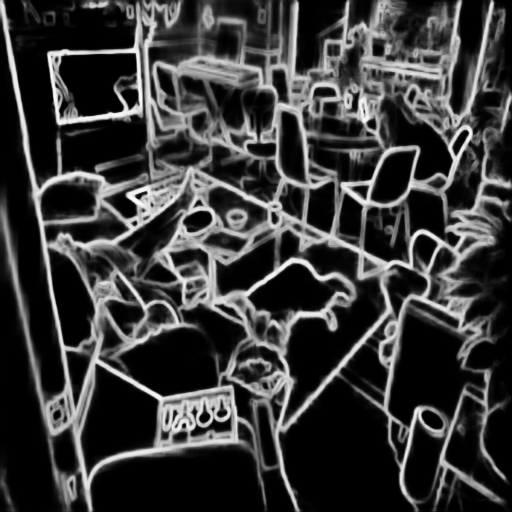

In [ ]:
import cv2
from PIL import Image
import numpy as np
from controlnet_aux import HEDdetector

hed = HEDdetector.from_pretrained('lllyasviel/ControlNet')

LOW_THRESH = 100
HIGH_THRESH = 200
def canny_image(filename):
  image_loaded = load_image(IMAGE_PATH+filename)

  image = np.array(image_loaded)

  canny_image = cv2.Canny(image, LOW_THRESH, HIGH_THRESH)
  img = canny_image[:, :, None]
  img = np.concatenate([img, img, img], axis=2)
  return Image.fromarray(img).resize((512, 512))



# We're mostly going to use hed. It's more expensive but it creates nicer outlines.
def hed_image(filename):
  image_loaded = load_image(IMAGE_PATH+filename)
  img = hed(image_loaded)
  return img.resize((512, 512))

hed_image(images[0])

## Img2Img + ControlNet

Stable Diffusion doesn't actually have an Img2Img ControlNet Pipeline, but the [WebUI does](https://github.com/AUTOMATIC1111/stable-diffusion-webui), so here we've forked the diffuser library and combined their implementation of Img2Img with their implementation of ControlNet.

We could have gotten decent enough results with just either of them, but especially since we're trying to create a variety of images we wanted to the flexiblity of using both. In my experience the combination is a tad better at maintaining textures.

### Technical
ControlNet works by doing additional processing during the each iterative loop of the algorithm. Img2Img works by biasing the original noise—instead of starting from complete randomness we start with something that has some statistical resemblance to the input image.

This means if we keep our latent space representations consistent the two algorithms don't have too much trouble fitting together.

If you'd like to understand the algorithm, my recommendation is diffing the different versions of this file (my own, the original StableDiffusionControlNetPipeline, and the StableDiffusionImg2ImgPipeline).

### Caveats

Just like with ControlNet alone it's important to be aware of image height/width. They should be set with something like PIL and they should match.

In [ ]:
# This code creates an Img2ImgControlNet and a plain ControlNet.

from diffusers import StableDiffusionImg2ImgControlNetPipeline, ControlNetModel
import torch

# number 1 is an Img2ImgControlnet pipeline.
controlnet = ControlNetModel.from_pretrained("lllyasviel/sd-controlnet-hed", torch_dtype=torch.float16)
pipe = StableDiffusionImg2ImgControlNetPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5", controlnet=controlnet, torch_dtype=torch.float16
)
from diffusers import StableDiffusionControlNetPipeline, ControlNetModel

# number 2 is a pure ControlNet pipeline without the img2img, so you can compare and choose.
controlnet2 = ControlNetModel.from_pretrained("lllyasviel/sd-controlnet-hed", torch_dtype=torch.float16)
pipe2 = StableDiffusionControlNetPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5", controlnet=controlnet, torch_dtype=torch.float16
)


Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

/usr/local/lib/python3.9/dist-packages/transformers/models/clip/feature_extraction_clip.py:28: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


In [ ]:
# Img2ImgControlNet
from diffusers import UniPCMultistepScheduler

pipe.scheduler = UniPCMultistepScheduler.from_config(pipe.scheduler.config)

# this command loads the individual model components on GPU on-demand.
pipe.enable_model_cpu_offload()
pipe.enable_xformers_memory_efficient_attention()

# Plain ControlNet
pipe2.scheduler = UniPCMultistepScheduler.from_config(pipe.scheduler.config)

pipe2.enable_model_cpu_offload()
pipe2.enable_xformers_memory_efficient_attention()


# Prompts
Here we create the actual prompts. I've left the ones I used for testing, which takes the first image, turn it into a sketch, then progressively make it darker.

In [ ]:
torch.cuda.empty_cache()
test_img = load_img(images[0]).resize((512, 512))
test_canny_img = canny_image(images[0])
test_hed_img = hed_image(images[0])

prompt = ["sketch, cross hatched, rough, black and white, grayscale,",
          "abstract, dark, spooky, faded, haunted, cyberpunk",
          "abstract, dark, spooky, faded, haunted, cyberpunk",
          "abstract, dark, spooky, faded, haunted, cyberpunk, distorted",
          "abstract, dark, spooky, faded, haunted, cyberpunk, distorted",
          "abstract, dark, spooky, faded, haunted, cyberpunk, distorted, bleeding, evil",
          "abstract, dark, spooky, faded, haunted, cyberpunk, distorted, bleeding, destoryed, burned, evil, broken",
          ]
generator = torch.Generator(device="cpu").manual_seed(1)

negative_prompt= ["worst quality, low res, low quality, bad anatomy, color",
                  "lowres, bad anatomy, worst quality",
                  "lowres, bad anatomy, worst quality",
                  "lowres, bad anatomy, worst quality",
                  "lowres, bad anatomy",
                  "lowres, bad anatomy",
                  "lowres, bad anatomy",
                  ] 

# Gen the Img2Img+ControlNet
output = pipe(
    prompt,
    test_img, #This variable is the Img2Img input.
    0.85, #This variable tunes how much of the original image to preserve. Lower values result in more randomness.
    test_hed_img,
    negative_prompt=negative_prompt,
    generator=generator,
    num_inference_steps=30,
)

torch.Size([7, 4, 64, 64])


/usr/local/lib/python3.9/dist-packages/diffusers/pipelines/stable_diffusion/pipeline_stable_diffusion_img2img_controlnet.py:793: FutureWarning: You have passed 7 text prompts (`prompt`), but only 1 initial images (`image`). Initial images are now duplicating to match the number of text prompts. Note that this behavior is deprecated and will be removed in a version 1.0.0. Please make sure to update your script to pass as many initial images as text prompts to suppress this warning.
  deprecate("len(prompt) != len(image)", "1.0.0", deprecation_message, standard_warn=False)


  0%|          | 0/25 [00:00<?, ?it/s]

In [ ]:
generator = torch.Generator(device="cpu").manual_seed(1)

output2 = pipe2(
    prompt,
    test_hed_img, # HED image from earlier.
    negative_prompt=negative_prompt,
    generator=generator,
    num_inference_steps=20,
)

torch.Size([7, 4, 64, 64])


  0%|          | 0/20 [00:00<?, ?it/s]

# Img2Img ControlNet Results
8


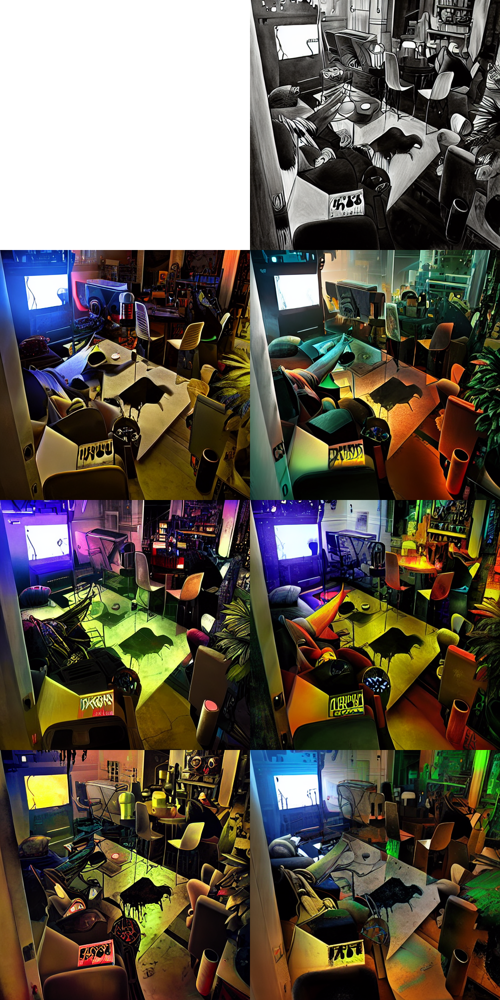

In [ ]:

# Print out the Img2ImgControlNet results.
white = Image.new("RGB", size=[512,512], color='white')
def image_grid(imgs, rows, cols):
    print(len(imgs))
    assert len(imgs) == rows * cols

    w, h = imgs[0].size
    grid = Image.new("RGB", size=(cols * w, rows * h))
    grid_w, grid_h = grid.size

    for i, img in enumerate(imgs):
        grid.paste(img, box=(i % cols * w, i // cols * h))
    return grid

print("# Img2Img ControlNet Results")
image_grid([white]+output.images, 4, 2)

#Just ControlNet Results
8


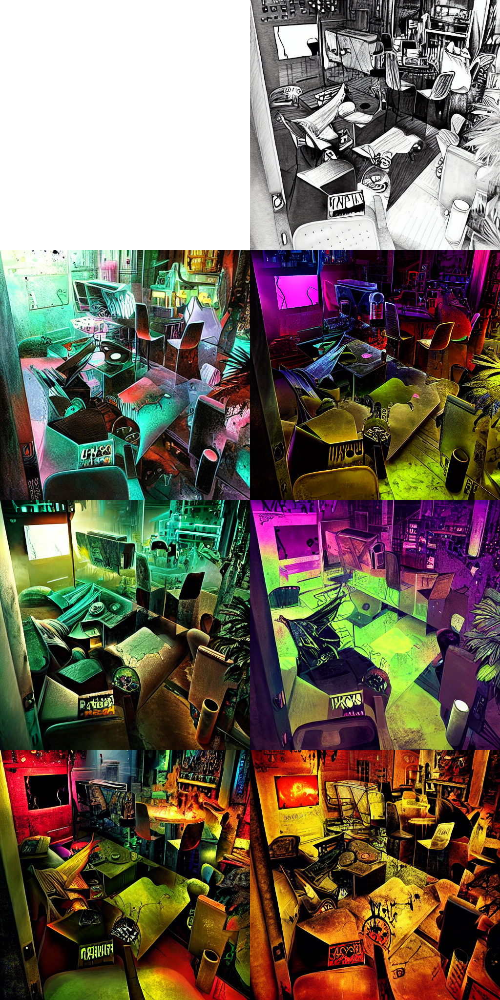

In [ ]:
white2 = Image.new("RGB", size=[512,512], color='white')

print("#Just ControlNet Results")
image_grid([white2]+output2.images, 4, 2)

In [ ]:
def save_images(img_arr, index=0):
  i = 0
  for image in img_arr:
    image.save('out/outimg_'+str(index)+'_'+str(i)+'.jpg')
    i+=1

In [ ]:
# Run this to save the outputs.
!mkdir out
save_images(output.images, 0)
save_images(output2.images, 1)

mkdir: cannot create directory ‘out’: File exists


#FILM
From here we want to interpolate between the different images in hopefully interesting way.

This is extremely similar to the film notebook, just modified with an extra parameter called `--bounce` that increases how often the insert frames get copied into the final interpolation—effectively giving a "freeze" or "bounce" effect as we interpolate from image to image.

If you're going for a perfectly smooth interpolation you probably want this set to 0. Otherwise, experiment!

In [ ]:
#@title ##Clone the frame-interpolation source code from `github.com/google-research`
!pwd

# remove to reinstall
# !rm -rf frame-interpolation/
if not os.path.isdir(f'frame-interpolation'):
  !git clone https://github.com/JuliaMerz/frame-interpolation


/content/drive/MyDrive/cnetsinsua


In [ ]:
#@title ##Install FILM, download pretrained_models from `google-drive`
!pip install -r frame-interpolation/requirements.txt
if not os.path.isdir(f'frame-interpolation/pretrained_models'):
  %cd frame-interpolation/
  !gdown 1C1YwOo293_yrgSS8tAyFbbVcMeXxzftE -O pretrained_models-20220214T214839Z-001.zip
  !unzip -o "pretrained_models-20220214T214839Z-001.zip"
  !rm -rf pretrained_models-20220214T214839Z-001.zip
  %cd ..

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 458.4/458.4 MB 3.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.0/4.0 MB 92.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 62.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.4/129.4 kB 16.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 57.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.6/2.6 MB 87.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.2/135.2 kB 17.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.5/78.5 kB 10.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 462.9/462.9 kB 40.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 69.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━

In [ ]:
input_folder = '/content/drive/MyDrive/cnetsinsua/out' #@param {type:"string"}
recursion_times = 7 #@param {type:"slider", min:1, max:10, step:1}
bounce=15 #@param {type:"slider", min:1, max:100}

## at recursion of 6 it's ~64 frames per interpolation, at 7 it's ~128, etc. 

model_path = 'frame-interpolation/pretrained_models/film_net/Style/saved_model'
!python3 -m frame-interpolation.eval.interpolator_cli \
   --pattern $input_folder \
   --model_path $model_path \
   --times_to_interpolate $recursion_times \
   --bounce $bounce \
   --output_video

/usr/local/lib/python3.9/dist-packages/apache_beam/__init__.py:79: UserWarning: This version of Apache Beam has not been sufficiently tested on Python 3.9. You may encounter bugs or missing features.
  warnings.warn(
W0415 02:19:40.543349 140085233084224 environments.py:371] Make sure that locally built Python SDK docker image has Python 3.9 interpreter.
I0415 02:19:40.543509 140085233084224 environments.py:380] Default Python SDK image for environment is apache/beam_python3.9_sdk:2.34.0
I0415 02:19:40.569143 140085233084224 translations.py:678] ==================== <function annotate_downstream_side_inputs at 0x7f67419f49d0> ====================
I0415 02:19:40.569382 140085233084224 translations.py:678] ==================== <function fix_side_input_pcoll_coders at 0x7f67419f4af0> ====================
I0415 02:19:40.569486 140085233084224 translations.py:678] ==================== <function pack_combiners at 0x7f67419f5040> ====================
I0415 02:19:40.569757 140085233084224 tran

In [ ]:
import mediapy as media
video = media.read_video('out/interpolated.mp4')
media.show_video(video, fps=30)

# Putting It All Together

For a full video we'll want to do what we've done above, but do the loop iteratively.

Set up the following folders:
* `cnetsinsua/full_out/images` with the images you want in your final video.


In [ ]:
def save_images_root(path, img_arr, index=0):
  i = 0
  for image in img_arr:
    image.save(HOME+path+'out/outimg_'+str(index)+'_'+str(i)+'.jpg')
    i+=1

def load_img_root(path, filename):
  return load_image(HOME+path+filename)

def hed_image_root(path, filename):
  image_loaded = load_img_root(path, filename)
  img = hed(image_loaded)
  return img.resize((512, 512))


In [ ]:
# Clean up ahead of this run.
%cd /content/drive/MyDrive/cnetsinsua
!mkdir full_out/out/
!rm -rf full_out/out/*
song1_imgs = os.listdir('full_out/images')

white = Image.new("RGB", size=[512,512], color='white')

# If you want different prompts for different images, just unroll this loop
for count, img_name in enumerate(song1_imgs):
  img = load_img_root('full_out/images/', img_name).resize((512, 512))
  hed_img = hed_image_root('full_out/images/', img_name)

  prompt = ["sketch, cross hatched, pencil, high quality, black and white",
            "abstract, cyberpunk, purple, best quality, dark, spooky, faded, haunted",
            "abstract, cyberpunk, red, best quality, dark, spooky, faded, haunted",
            "abstract, cyberpunk, crimson, best quality, dark, spooky, horror, faded, haunted, distorted",
            "cyberpunk, crimson, gothic, horror, dark, spooky, faded, bloody, destroyed, grainy, haunted, distorted, polaroid",
            ]
  negative_prompt = ["lowres, bad anatomy, worst quality, low quality",
                     "lowres, bad anatomy, worst quality, low quality",
                     "lowres, bad anatomy, worst quality, low quality",
                     "lowres, bad anatomy, worst quality, natural",
                     "lowres, bad anatomy, natural, real",
                     ]
  generator = torch.Generator(device="cpu").manual_seed(1)

  output = pipe(
      prompt,
      img,
      0.9,
      hed_img,
      negative_prompt=negative_prompt,
      generator=generator,
      num_inference_steps=35,
  )

  # If you're trying to smoothly interpolate between related images
  # just remove [white] from this save command.
  save_images_root('full_out/', [white]+output.images, count)


input_folder = '/content/drive/MyDrive/cnetsinsua/full_out/out' 
recursion_times = 7 
bounce = 10
# These settings equate to 4.6 seconds per frame.

model_path = 'frame-interpolation/pretrained_models/film_net/Style/saved_model'
!python3 -m frame-interpolation.eval.interpolator_cli \
   --pattern $input_folder \
   --model_path $model_path \
   --times_to_interpolate $recursion_times \
  --bounce $bounce \
   --output_video

import mediapy as media
video = media.read_video('full_out/out/interpolated.mp4')
media.show_video(video, fps=30)

/content/drive/MyDrive/cnetsinsua
mkdir: cannot create directory ‘full_out/out/’: File exists
torch.Size([5, 4, 64, 64])


/usr/local/lib/python3.9/dist-packages/diffusers/pipelines/stable_diffusion/pipeline_stable_diffusion_img2img_controlnet.py:793: FutureWarning: You have passed 5 text prompts (`prompt`), but only 1 initial images (`image`). Initial images are now duplicating to match the number of text prompts. Note that this behavior is deprecated and will be removed in a version 1.0.0. Please make sure to update your script to pass as many initial images as text prompts to suppress this warning.
  deprecate("len(prompt) != len(image)", "1.0.0", deprecation_message, standard_warn=False)


  0%|          | 0/31 [00:00<?, ?it/s]

torch.Size([5, 4, 64, 64])


  0%|          | 0/31 [00:00<?, ?it/s]

torch.Size([5, 4, 64, 64])


  0%|          | 0/31 [00:00<?, ?it/s]

torch.Size([5, 4, 64, 64])


  0%|          | 0/31 [00:00<?, ?it/s]

torch.Size([5, 4, 64, 64])


  0%|          | 0/31 [00:00<?, ?it/s]

/usr/local/lib/python3.9/dist-packages/apache_beam/__init__.py:79: UserWarning: This version of Apache Beam has not been sufficiently tested on Python 3.9. You may encounter bugs or missing features.
  warnings.warn(
W0415 02:50:40.237831 140336571455296 environments.py:371] Make sure that locally built Python SDK docker image has Python 3.9 interpreter.
I0415 02:50:40.237984 140336571455296 environments.py:380] Default Python SDK image for environment is apache/beam_python3.9_sdk:2.34.0
I0415 02:50:40.261304 140336571455296 translations.py:678] ==================== <function annotate_downstream_side_inputs at 0x7fa1c9fd39d0> ====================
I0415 02:50:40.261516 140336571455296 translations.py:678] ==================== <function fix_side_input_pcoll_coders at 0x7fa1c9fd3af0> ====================
I0415 02:50:40.261624 140336571455296 translations.py:678] ==================== <function pack_combiners at 0x7fa1c9fd4040> ====================
I0415 02:50:40.261867 140336571455296 tran